# Image Matching Challenge - EDA

For this challenge, images of 16 famous buildings/sites were provided. EDA was performed to get a general overview over the images and their properties.

In [14]:
import pandas as pd
import numpy as np
import os
import csv
import random
import cv2
import glob
import seaborn as sns
import matplotlib.pylab as plt

# Setting image directory. Every building has its own folder and a subfolder 'images'
input_dir = '../data/train'

In [15]:
# Generates a list of all building folder names
scenes = next(os.walk(input_dir))[1]
scenes.sort()
scenes

['brandenburg_gate',
 'british_museum',
 'buckingham_palace',
 'colosseum_exterior',
 'grand_place_brussels',
 'lincoln_memorial_statue',
 'notre_dame_front_facade',
 'pantheon_exterior',
 'piazza_san_marco',
 'sacre_coeur',
 'sagrada_familia',
 'st_pauls_cathedral',
 'st_peters_square',
 'taj_mahal',
 'temple_nara_japan',
 'trevi_fountain']

## Number of Images

First, we wanted to find out, how many images were provided for each building.

In [16]:
# Counting the number of images for each scene
df = pd.DataFrame()
df['scene'] = scenes

len_list = []

for scene in scenes:
    path = os.path.join(input_dir, scene,'images') 
    len_list.append(len(os.listdir(path)))
    
df['no_images'] = len_list

df

,scene,no_images
0,brandenburg_gate,350
1,british_museum,176
2,buckingham_palace,446
3,colosseum_exterior,499
4,grand_place_brussels,236
5,lincoln_memorial_statue,214
6,notre_dame_front_facade,911
7,pantheon_exterior,321
8,piazza_san_marco,68
9,sacre_coeur,281


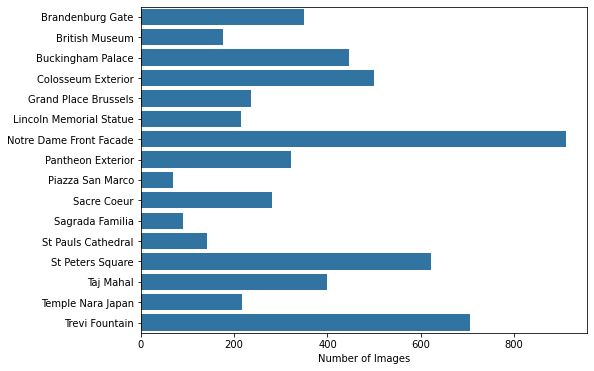

In [17]:
# Plotting the number of images for each scene
scenes_formatted = [scene.title().replace("_", " ") for scene in scenes]

plt.figure(figsize=(8,6)) 
#plt.figure(dpi= 300) # use this for a high quality figure
ax = sns.barplot(x = df.no_images, y = df.scene, color='tab:blue')
ax.set_xlabel('Number of Images')
ax.set_ylabel(None)
ax.set_yticklabels(scenes_formatted);

## Image sizes

Next, we wanted to check the format and size of the training images.

In [18]:
# Getting scene, image id, height and width for each image
scene_list = []
imageid_list= []
height_list = []
width_list = []

for scene in df['scene']:
    path = os.path.join(input_dir,scene,'images') 
    for image in next(os.walk(path))[2]:
        imgpath = os.path.join(path,image) 
        img = cv2.imread(imgpath, cv2.IMREAD_UNCHANGED)
        scene_list.append(scene)
        imageid_list.append(image)
        height_list.append(img.shape[0])
        width_list.append(img.shape[1])

In [19]:
# Putting all the acquires size data into a pandas DataFrama
df_sizes = pd.DataFrame(columns = ['image_id', 'scene', 'width', 'height'])

df_sizes.scene, df_sizes.image_id, df_sizes.width, df_sizes.height = scene_list, imageid_list, width_list, height_list

df_sizes

,image_id,scene,width,height
0,17956239_927188867.jpg,brandenburg_gate,1028,769
1,10624116_2746543073.jpg,brandenburg_gate,1001,751
2,03890690_2728701915.jpg,brandenburg_gate,1023,767
3,18348543_5140101294.jpg,brandenburg_gate,1031,687
4,50607370_12607638855.jpg,brandenburg_gate,779,1052
...,...,...,...,...
5673,37200631_5423631680.jpg,trevi_fountain,1020,937
5674,91592261_8607422160.jpg,trevi_fountain,1043,688
5675,24417070_6262640016.jpg,trevi_fountain,1063,696
5676,64431184_3396577501.jpg,trevi_fountain,1054,696


In [20]:
df_sizes.describe()

,width,height
count,5678.000000,5678.000000
mean,933.224727,786.890983
std,176.213144,166.595722
min,113.000000,103.000000
25%,780.000000,689.000000
50%,1028.000000,772.000000
75%,1050.000000,813.750000
max,1229.000000,1131.000000


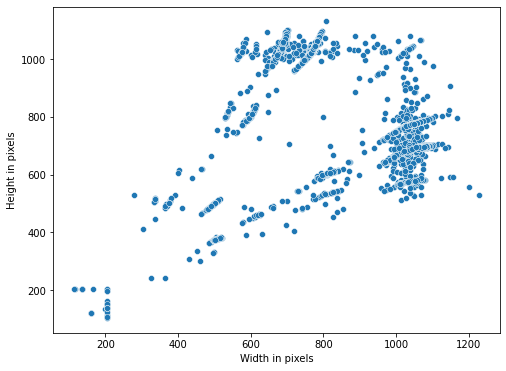

In [21]:
plt.figure(figsize=(8,6))
#plt.figure(dpi= 300) # use this for a high quality figure
ax = sns.scatterplot(data = df_sizes, x = 'width', y = 'height', legend=None, color='tab:blue')
ax.set_xlabel('Width in pixels')
ax.set_ylabel('Height in pixels');

## Image Samples

Here, a random example image from each scene is shown.

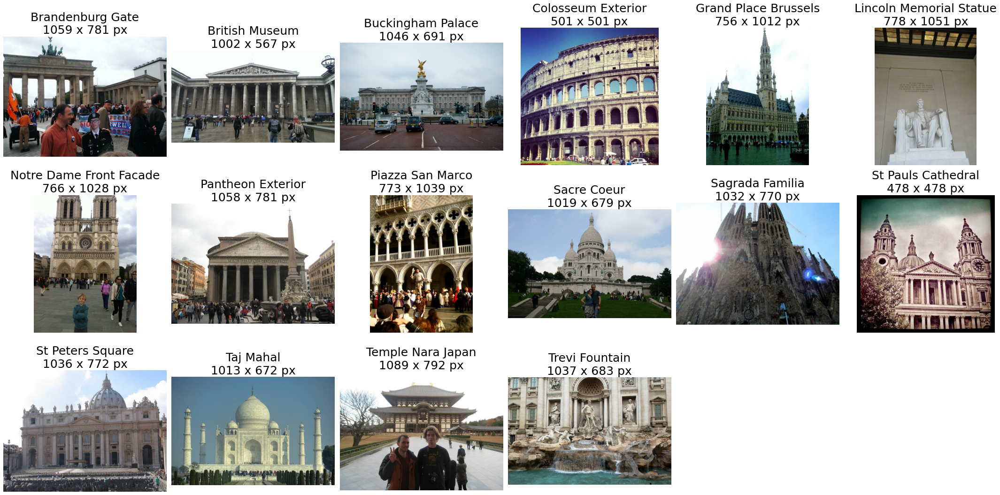

In [22]:
# setting the overall figure size
plt.figure(figsize=(30,15)) 

# setting the subplot grid
nrows = 3
ncols = 6

for i, scene in enumerate(df['scene']):
    sp = plt.subplot(nrows, ncols, i+1)
    path = os.path.join(input_dir,scene,'images') 
    files = os.listdir(path)
    rand_image = random.choice(files)
    imgpath = os.path.join(path,rand_image)
    img = cv2.imread(imgpath, cv2.IMREAD_UNCHANGED)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    sp.axis('off')
    sp.set_xlabel(str(img.shape[1]) + ' x ' + str(img.shape[0]) + ' px')
    sp.set_title(scene.title().replace("_", " ") + "\n" + str(img.shape[1]) + ' x ' + str(img.shape[0]) + ' px', fontsize = 25)
    plt.imshow(img)
plt.tight_layout()

## Covisibility



In [23]:
def ReadCovisibilityData(filename):
    covisibility_dict = {}
    with open(filename) as f:
        reader = csv.reader(f, delimiter=',')
        for i, row in enumerate(reader):
            if i == 0:
                continue
            covisibility_dict[row[0]] = float(row[1])

    return covisibility_dict

In [24]:
covisibility_brandenburg_gate = ReadCovisibilityData('../data/train/brandenburg_gate/pair_covisibility.csv')
covisibility_british_museum = ReadCovisibilityData('../data/train/british_museum/pair_covisibility.csv')
covisibility_buckingham_palace = ReadCovisibilityData('../data/train/buckingham_palace/pair_covisibility.csv')
covisibility_colosseum_exterior = ReadCovisibilityData('../data/train/colosseum_exterior/pair_covisibility.csv')
covisibility_grand_place_brussels = ReadCovisibilityData('../data/train/grand_place_brussels/pair_covisibility.csv')
covisibility_lincoln_memorial_statue = ReadCovisibilityData('../data/train/lincoln_memorial_statue/pair_covisibility.csv')
covisibility_notre_dame_front_facade = ReadCovisibilityData('../data/train/notre_dame_front_facade/pair_covisibility.csv')
covisibility_pantheon_exterior = ReadCovisibilityData('../data/train/pantheon_exterior/pair_covisibility.csv')
covisibility_piazza_san_marco = ReadCovisibilityData('../data/train/piazza_san_marco/pair_covisibility.csv')
covisibility_sacre_coeur =ReadCovisibilityData('../data/train/sacre_coeur/pair_covisibility.csv')
covisibility_sagrada_familia = ReadCovisibilityData('../data/train/sagrada_familia/pair_covisibility.csv')
covisibility_st_pauls_cathedral = ReadCovisibilityData('../data/train/st_pauls_cathedral/pair_covisibility.csv')
covisibility_st_peters_square = ReadCovisibilityData('../data/train/st_peters_square/pair_covisibility.csv')
covisibility_taj_mahal = ReadCovisibilityData('../data/train/taj_mahal/pair_covisibility.csv')
covisibility_temple_nara_japan = ReadCovisibilityData('../data/train/temple_nara_japan/pair_covisibility.csv')
covisibility_trevi_fountain = ReadCovisibilityData('../data/train/trevi_fountain/pair_covisibility.csv')

In [25]:
covisibility_list = [covisibility_brandenburg_gate,covisibility_british_museum, covisibility_buckingham_palace, covisibility_colosseum_exterior, covisibility_grand_place_brussels,
                    covisibility_lincoln_memorial_statue, covisibility_notre_dame_front_facade, covisibility_pantheon_exterior, covisibility_piazza_san_marco, covisibility_sacre_coeur,
                    covisibility_sagrada_familia, covisibility_st_pauls_cathedral, covisibility_st_peters_square, covisibility_taj_mahal, covisibility_temple_nara_japan, 
                    covisibility_trevi_fountain]

Brandenburg Gate
Pairs from an easy subset


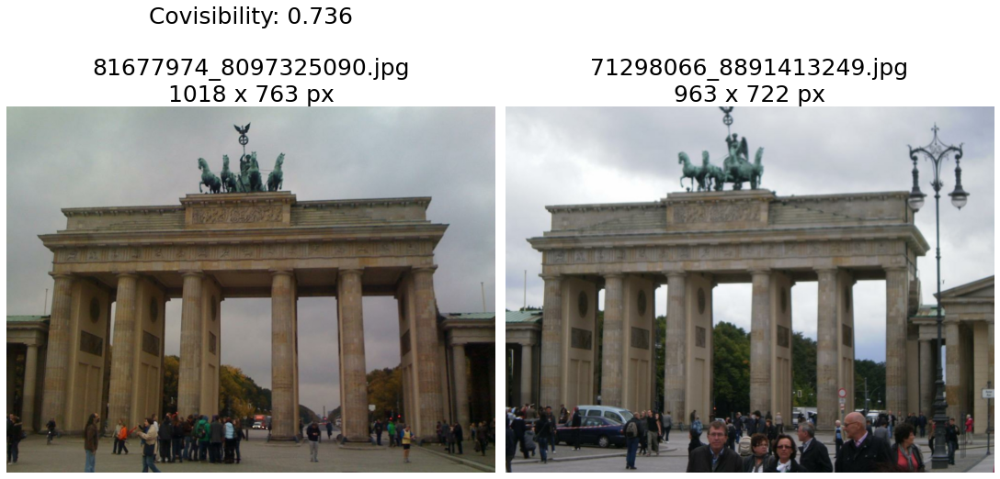

Pairs from a difficult subset


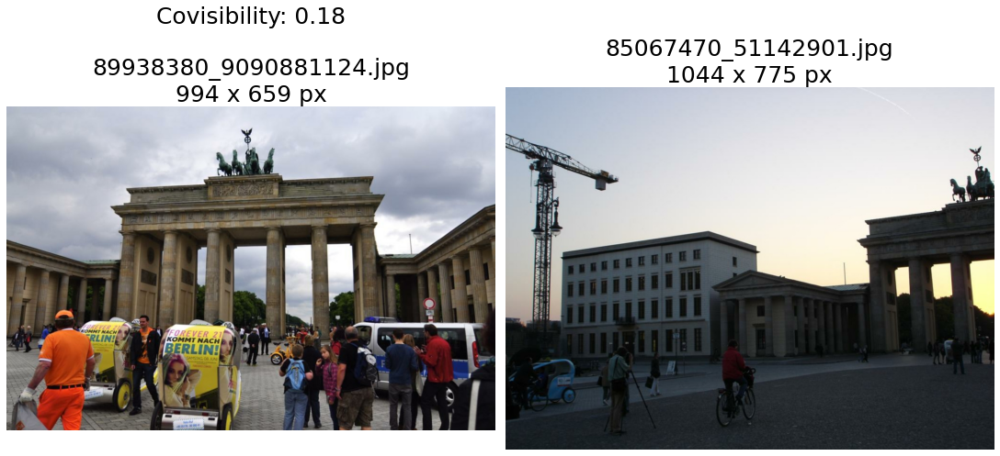

Pairs from a very difficult subset


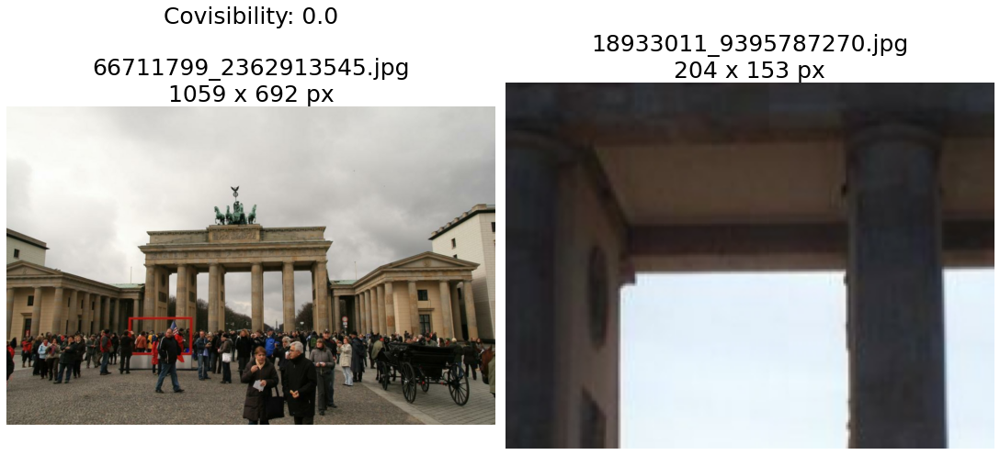

British Museum
Pairs from an easy subset


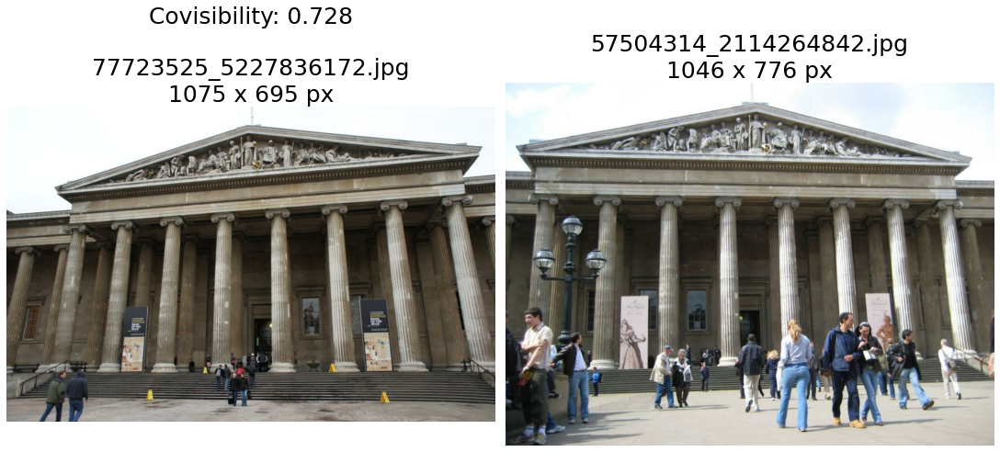

Pairs from a difficult subset


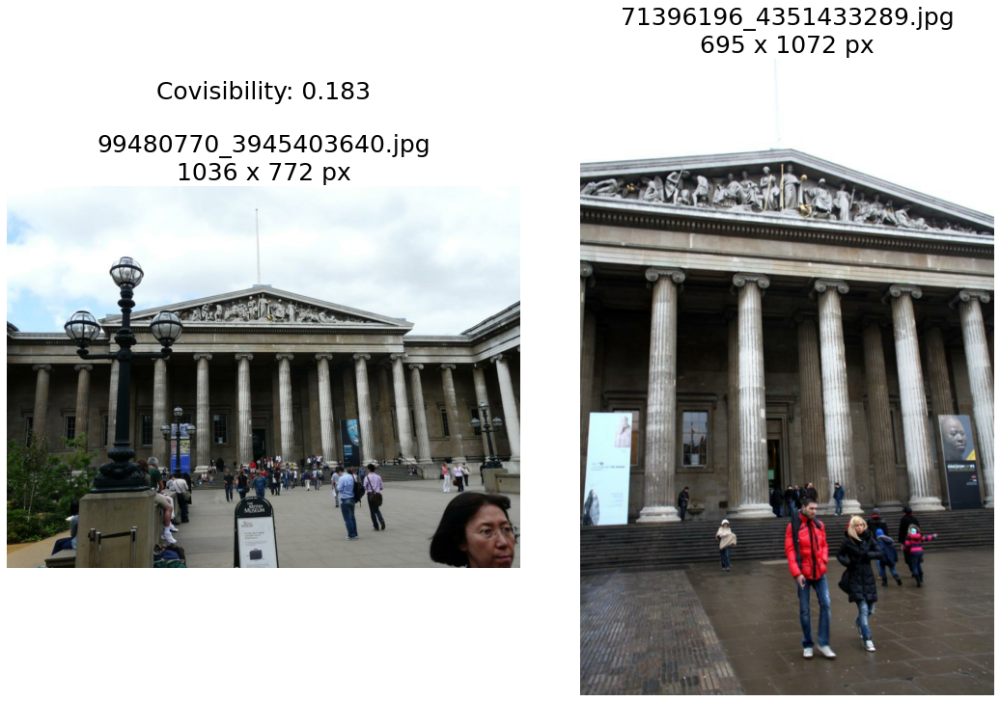

Pairs from a very difficult subset


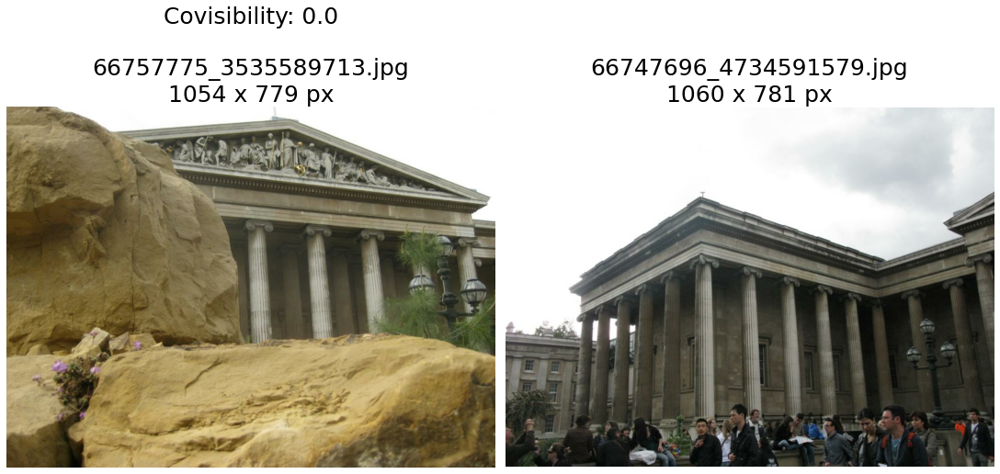

Buckingham Palace
Pairs from an easy subset


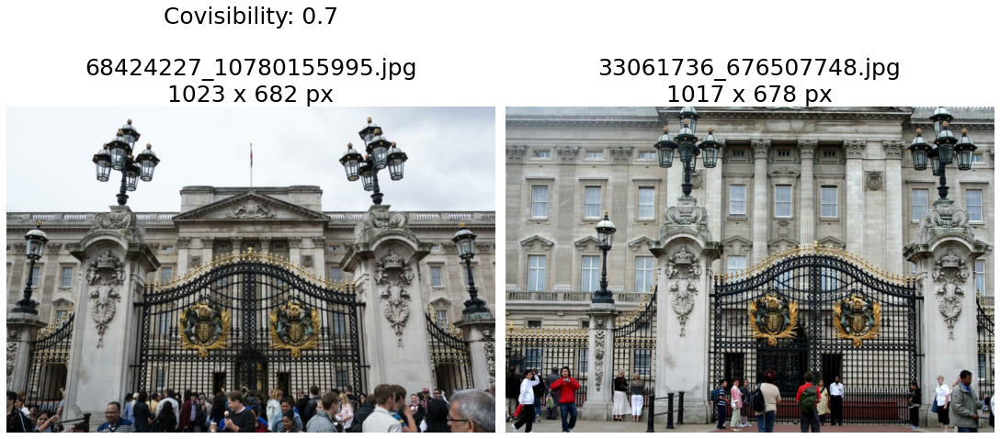

Pairs from a difficult subset


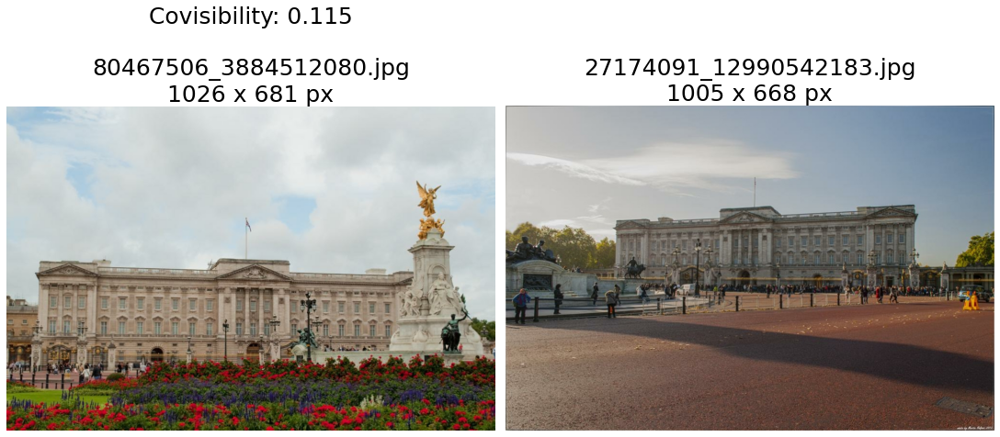

Pairs from a very difficult subset


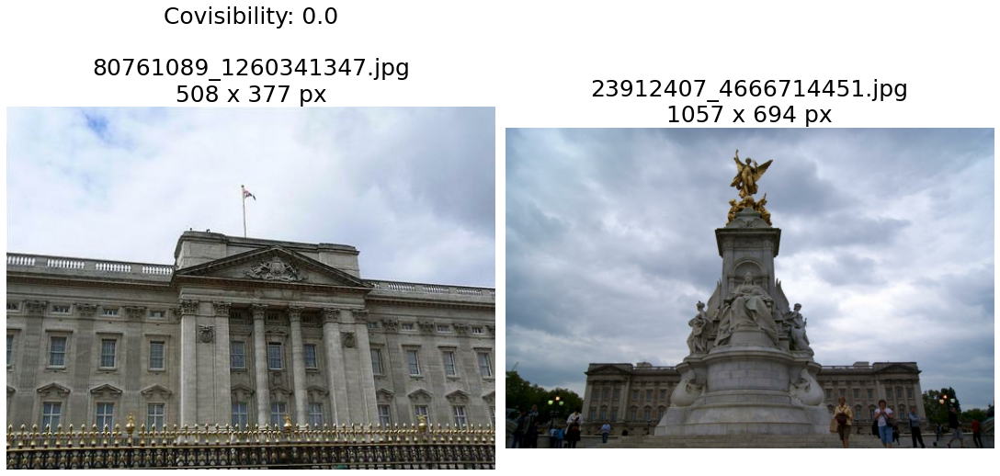

Colosseum Exterior
Pairs from an easy subset


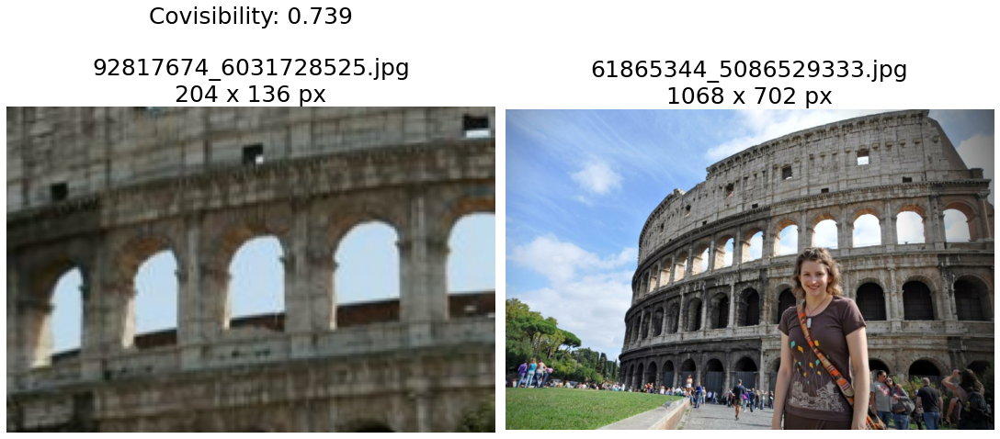

Pairs from a difficult subset


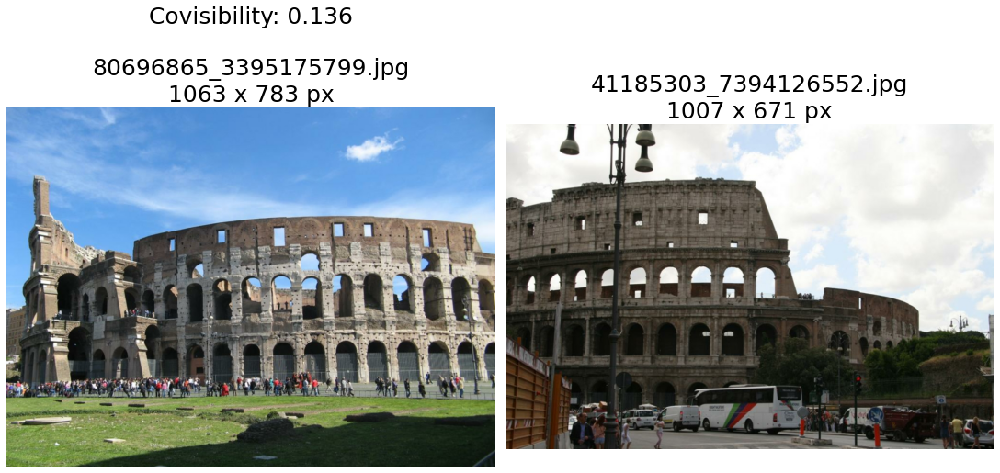

Pairs from a very difficult subset


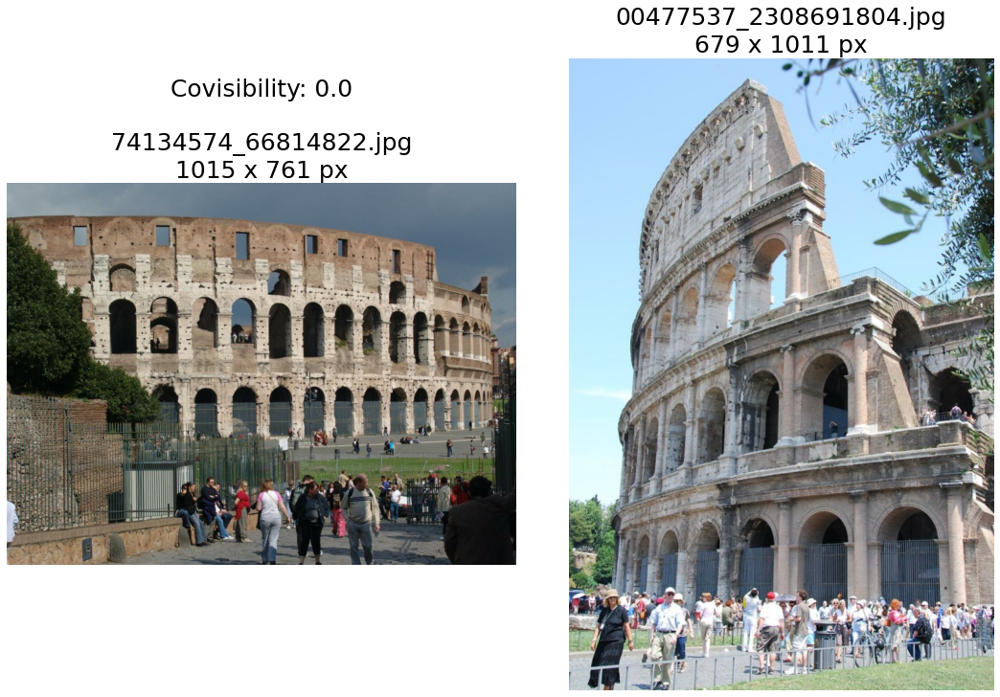

Grand Place Brussels
Pairs from an easy subset


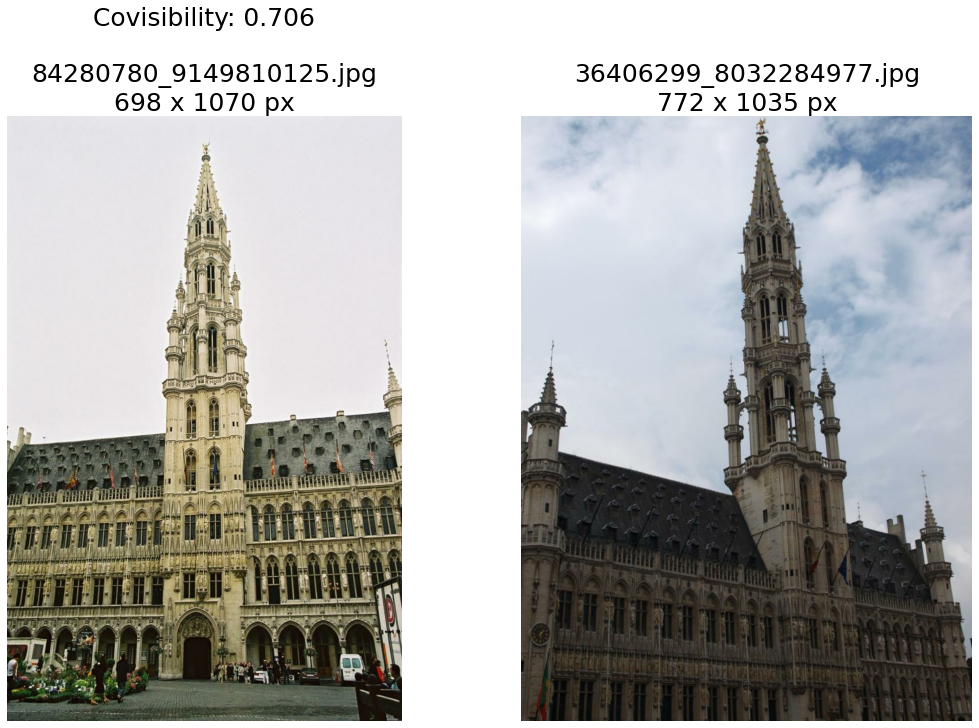

Pairs from a difficult subset


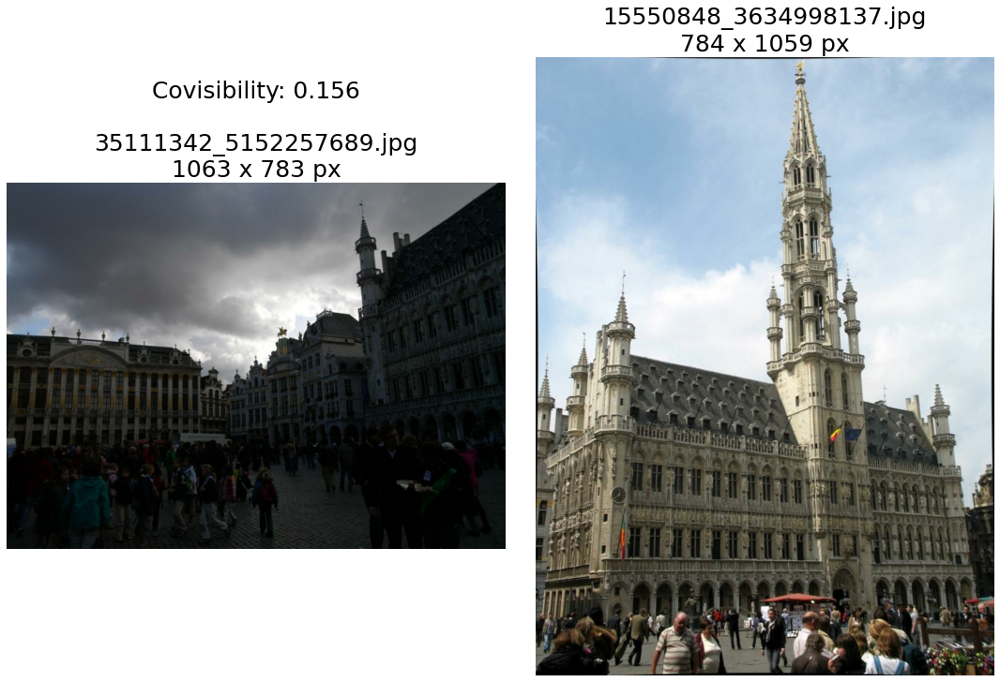

Pairs from a very difficult subset


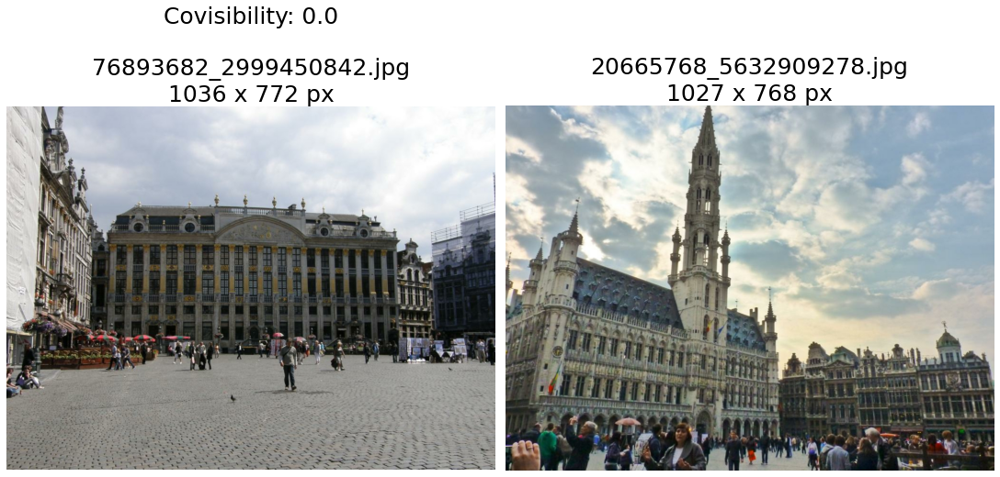

Lincoln Memorial Statue
Pairs from an easy subset


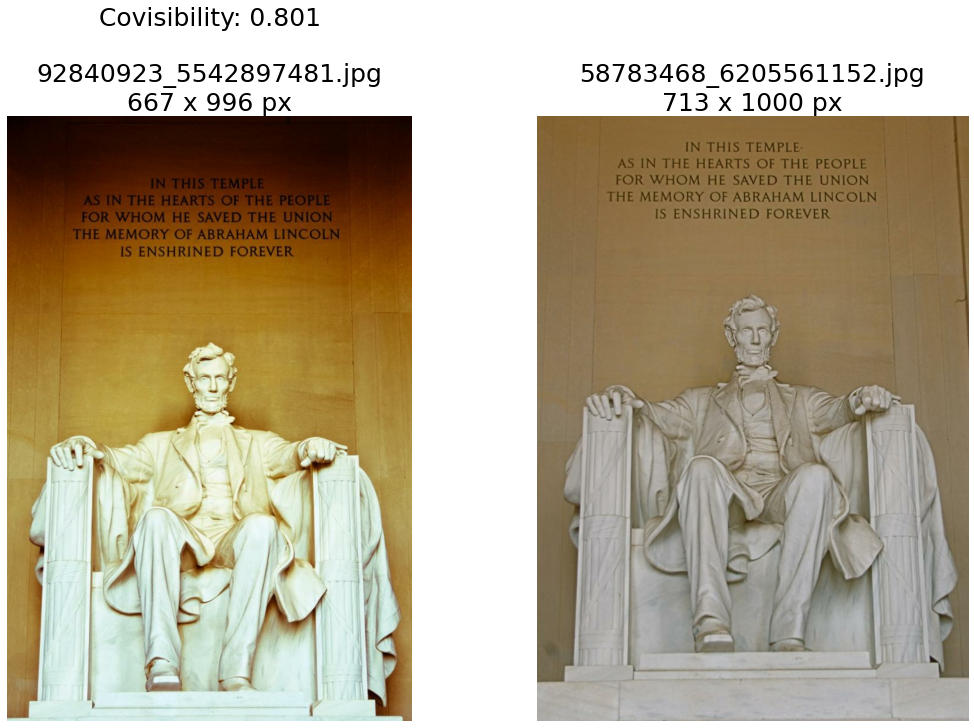

Pairs from a difficult subset


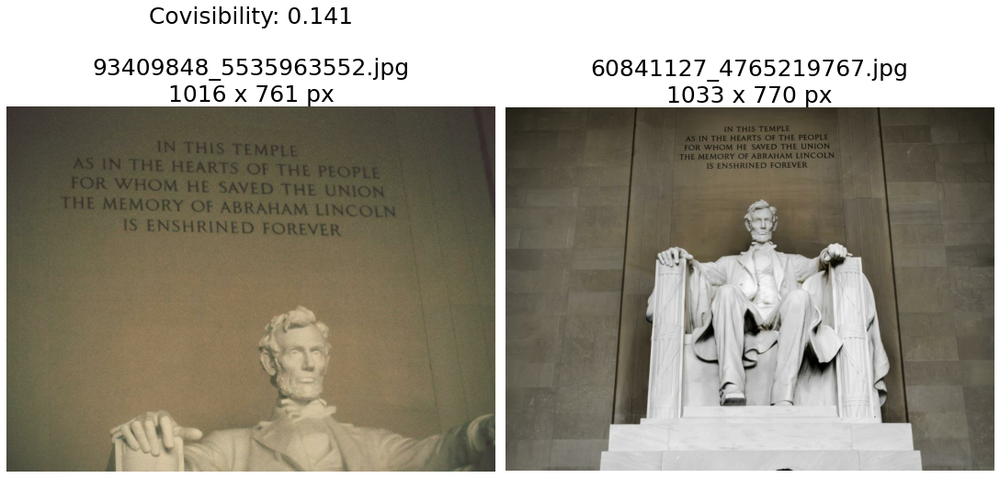

Pairs from a very difficult subset


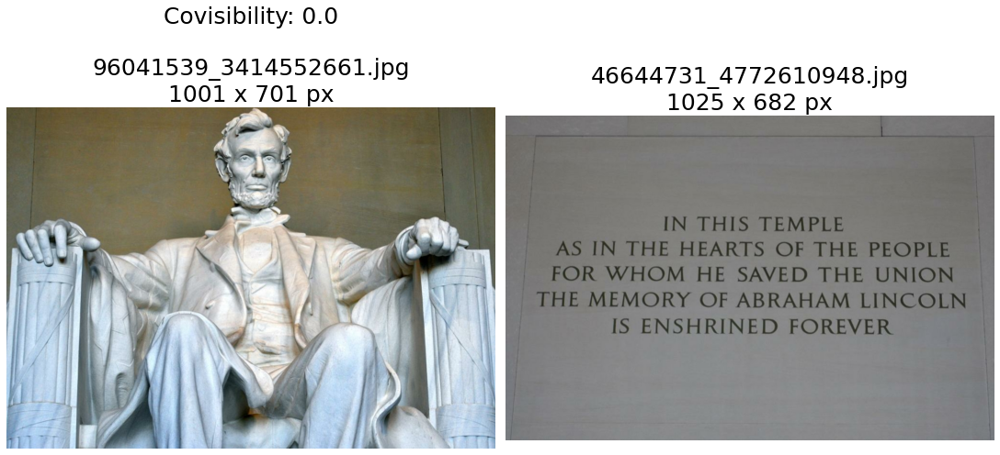

Notre Dame Front Facade
Pairs from an easy subset


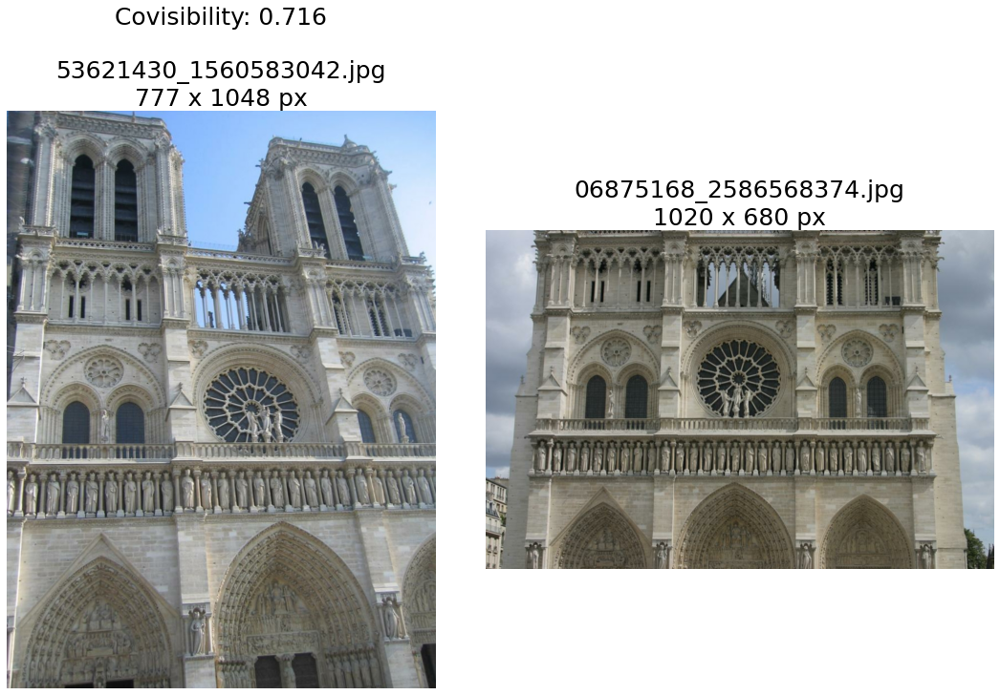

Pairs from a difficult subset


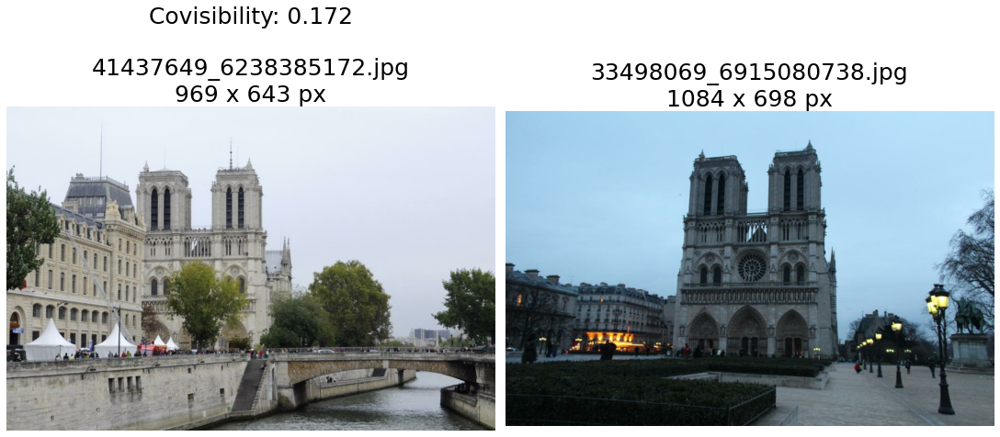

Pairs from a very difficult subset


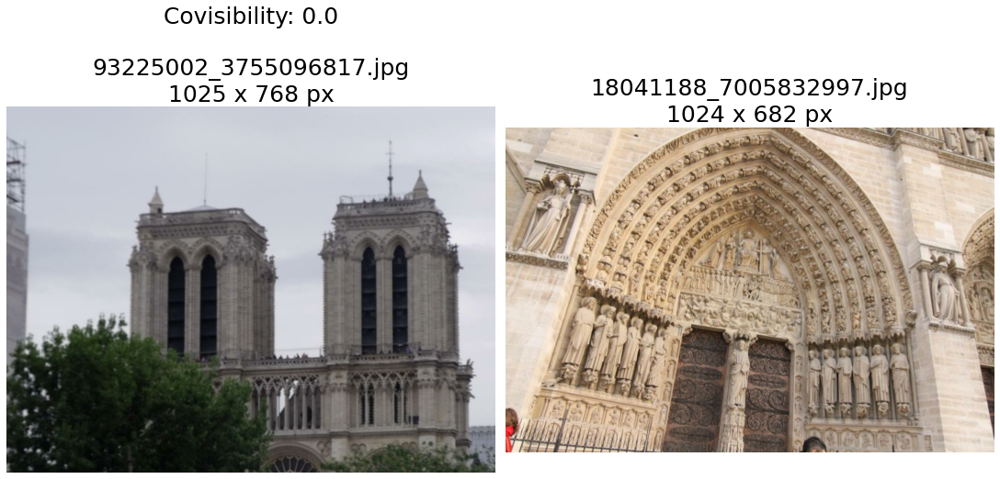

Pantheon Exterior
Pairs from an easy subset


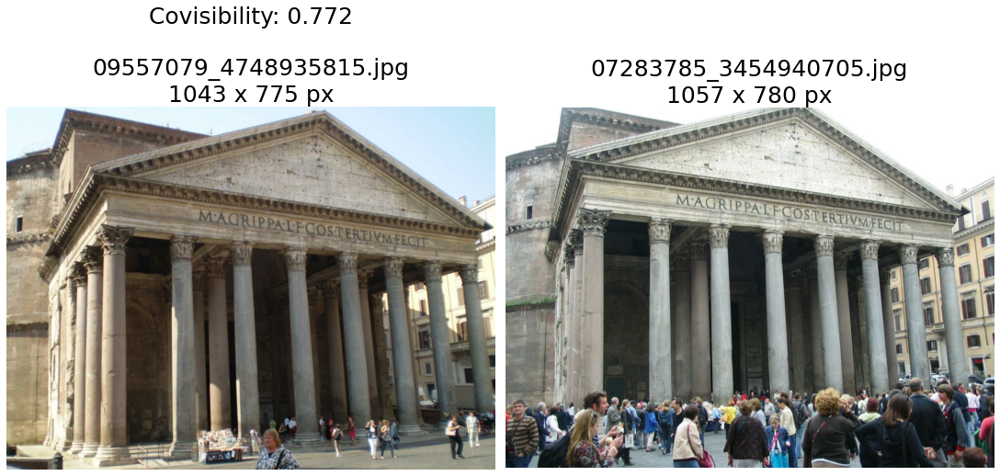

Pairs from a difficult subset


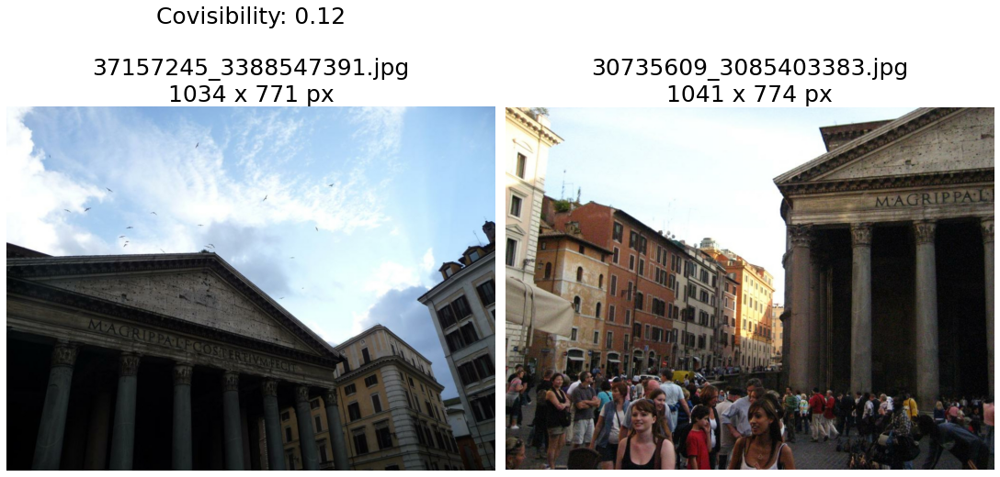

Pairs from a very difficult subset


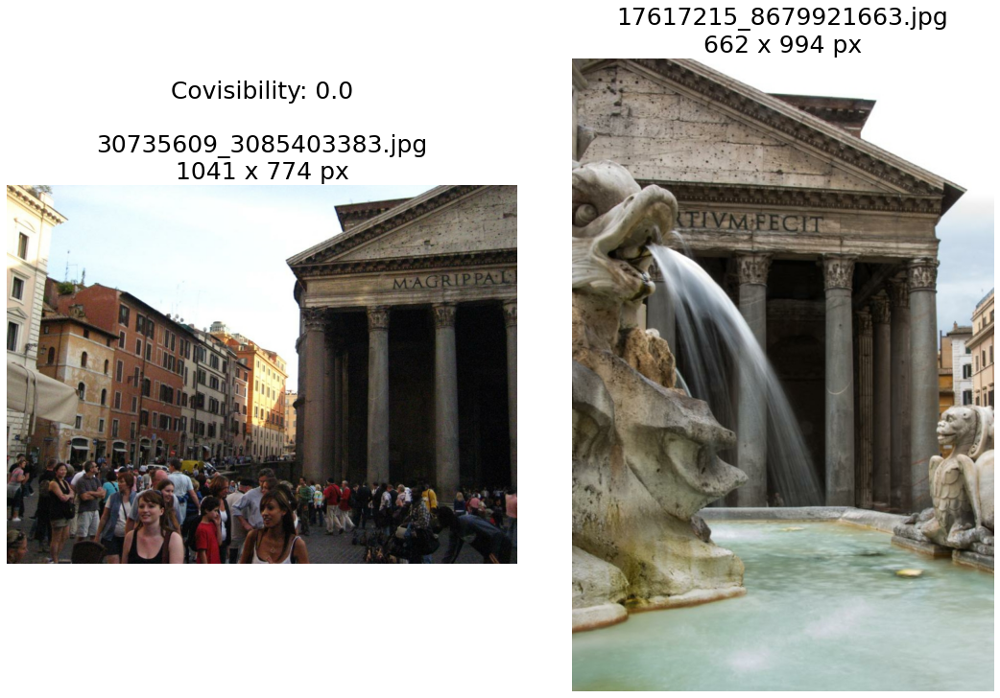

Piazza San Marco
Pairs from an easy subset


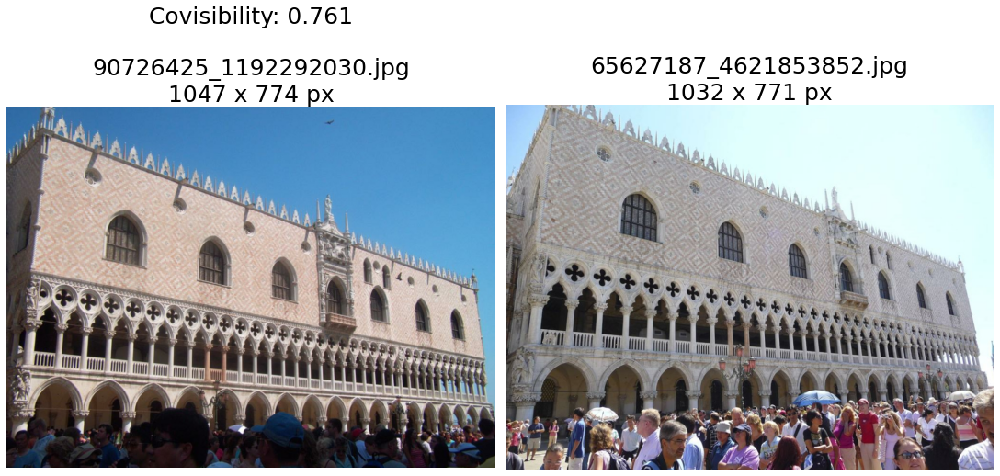

Pairs from a difficult subset


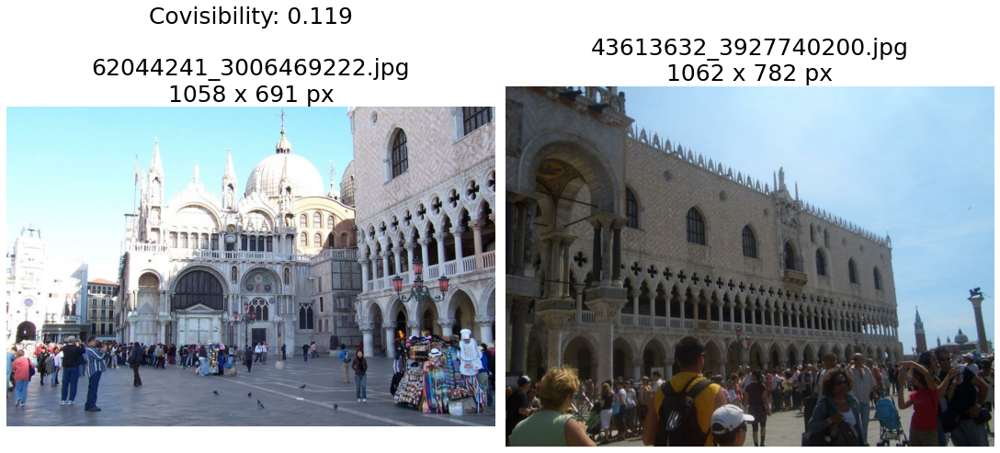

Pairs from a very difficult subset


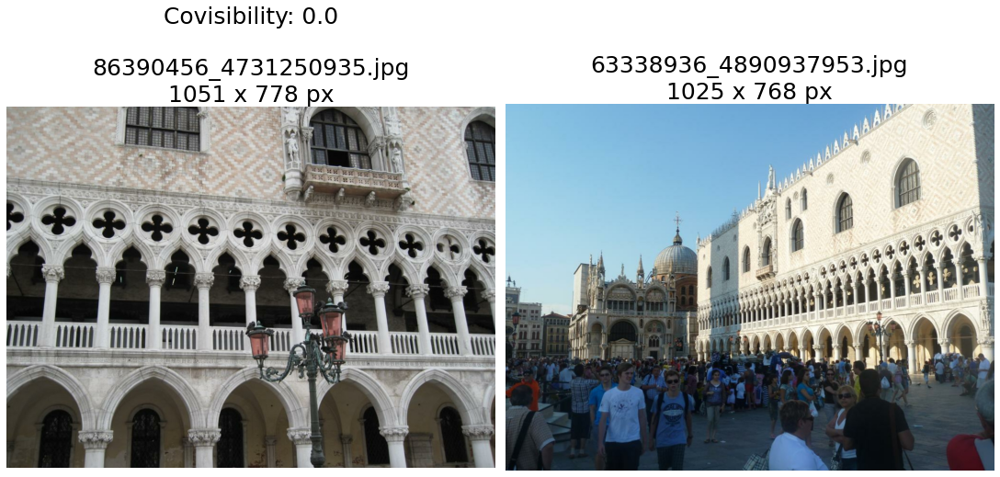

Sacre Coeur
Pairs from an easy subset


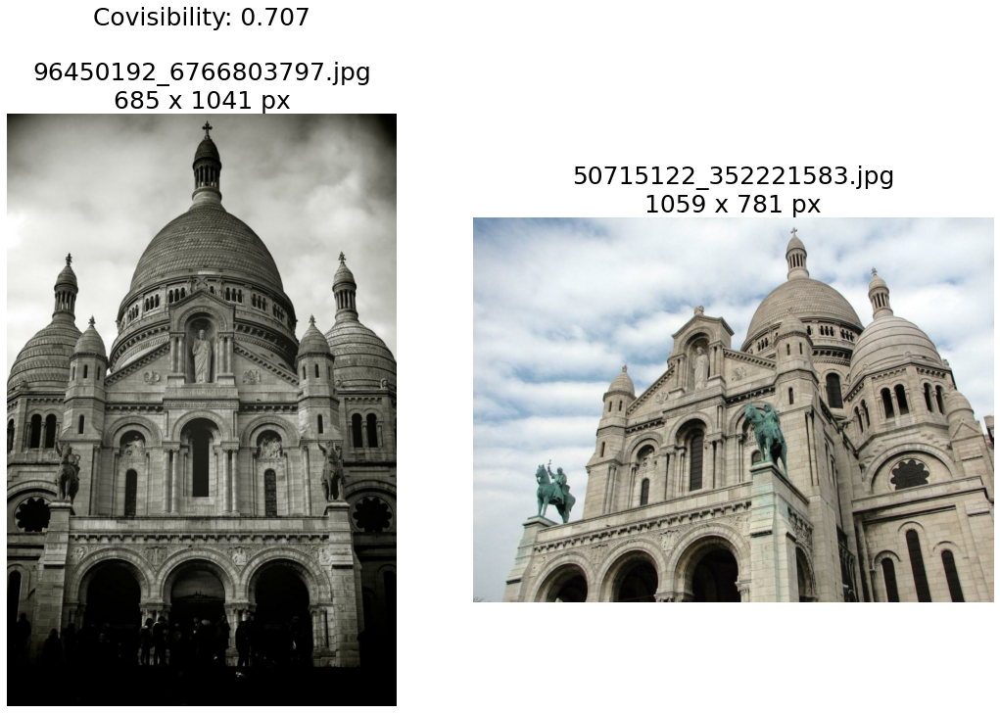

Pairs from a difficult subset


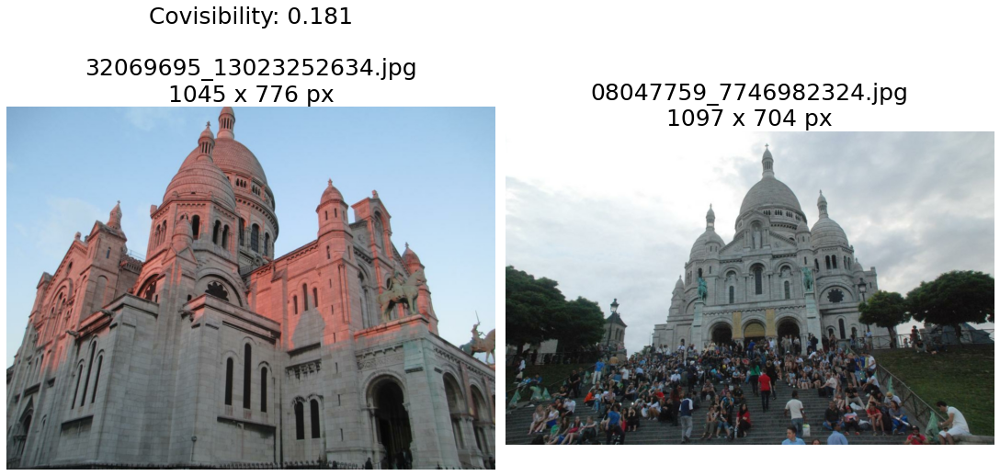

Pairs from a very difficult subset


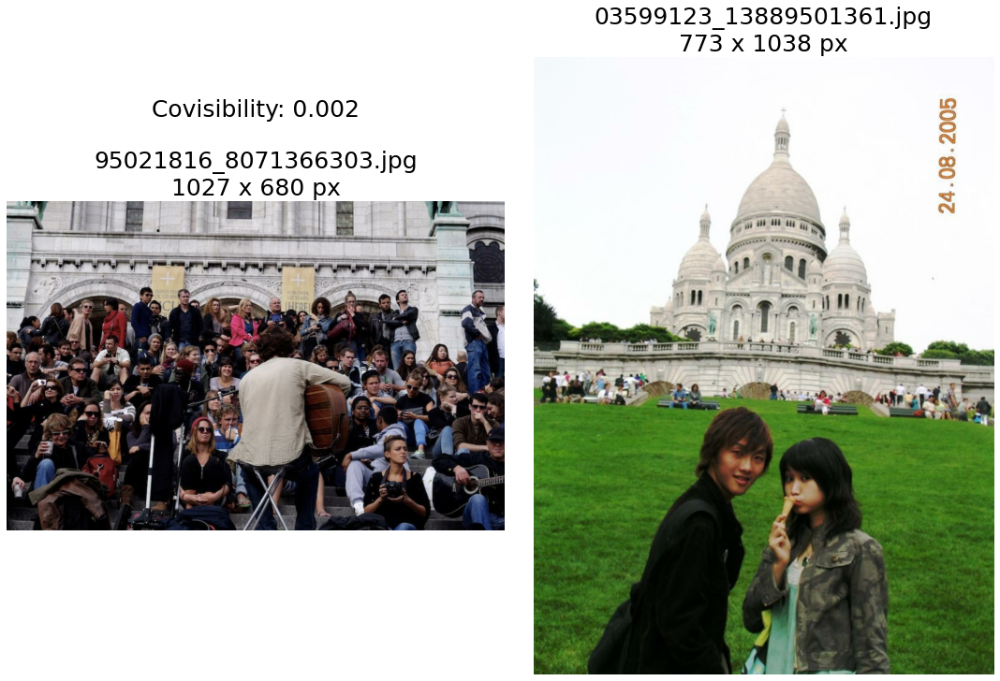

Sagrada Familia
Pairs from an easy subset


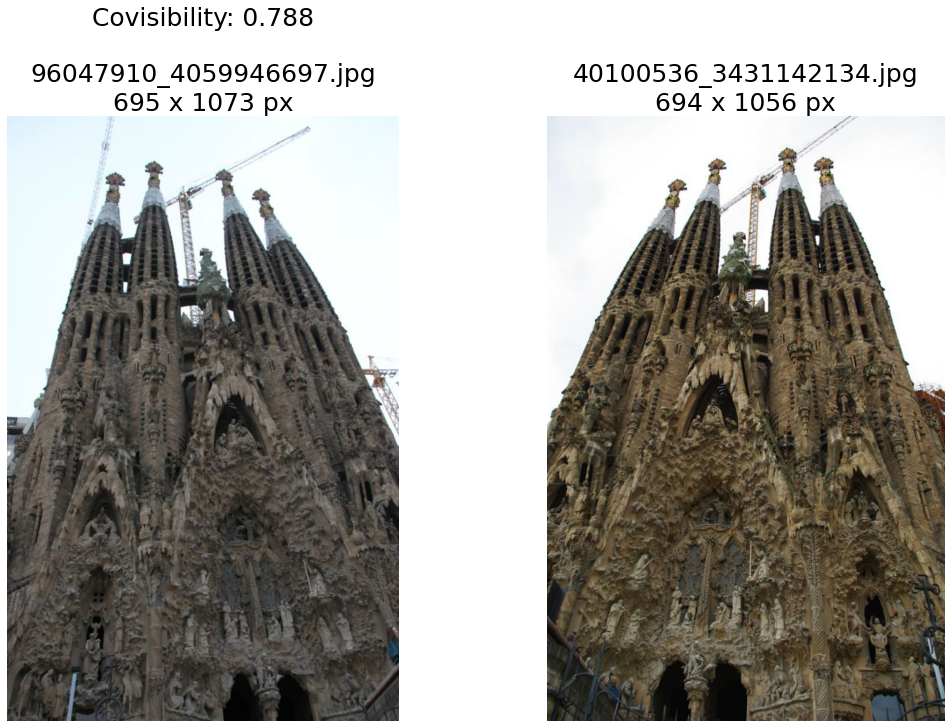

Pairs from a difficult subset


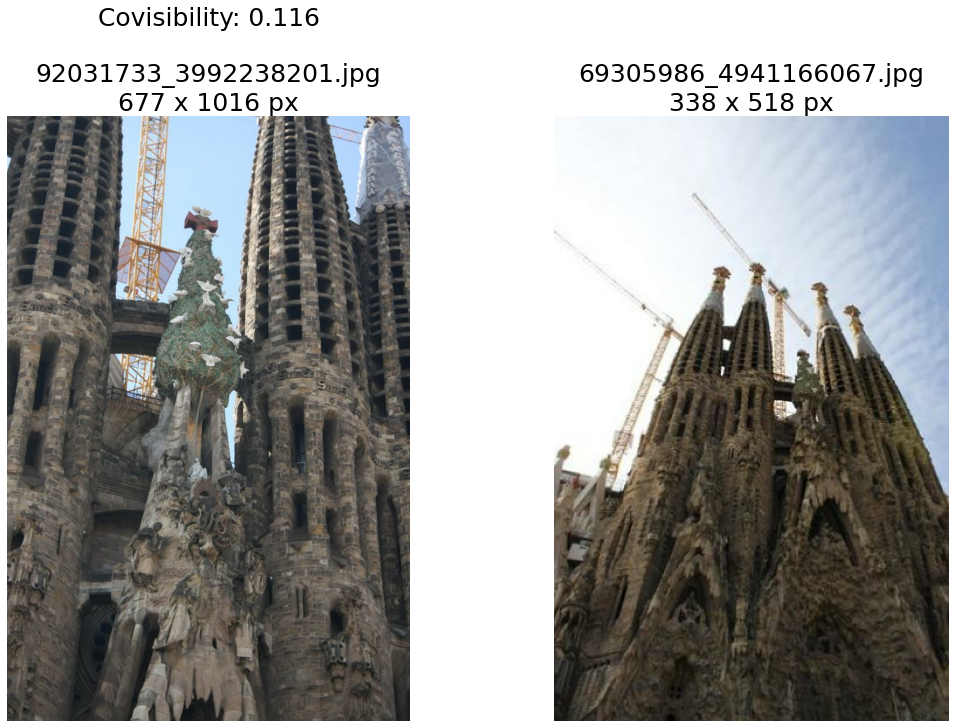

Pairs from a very difficult subset


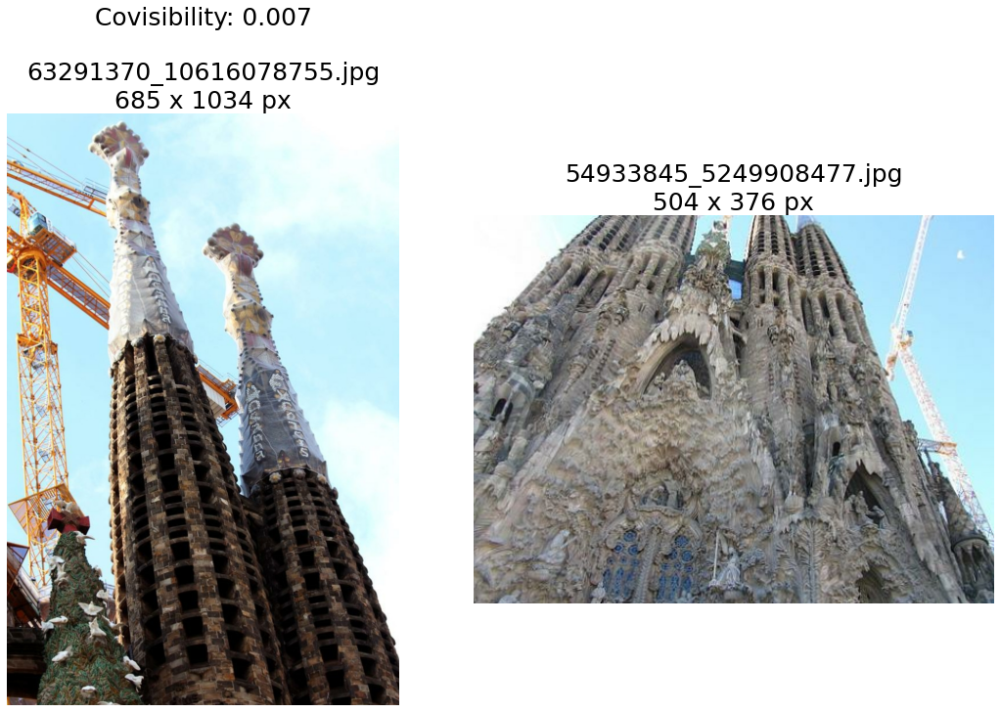

St Pauls Cathedral
Pairs from an easy subset


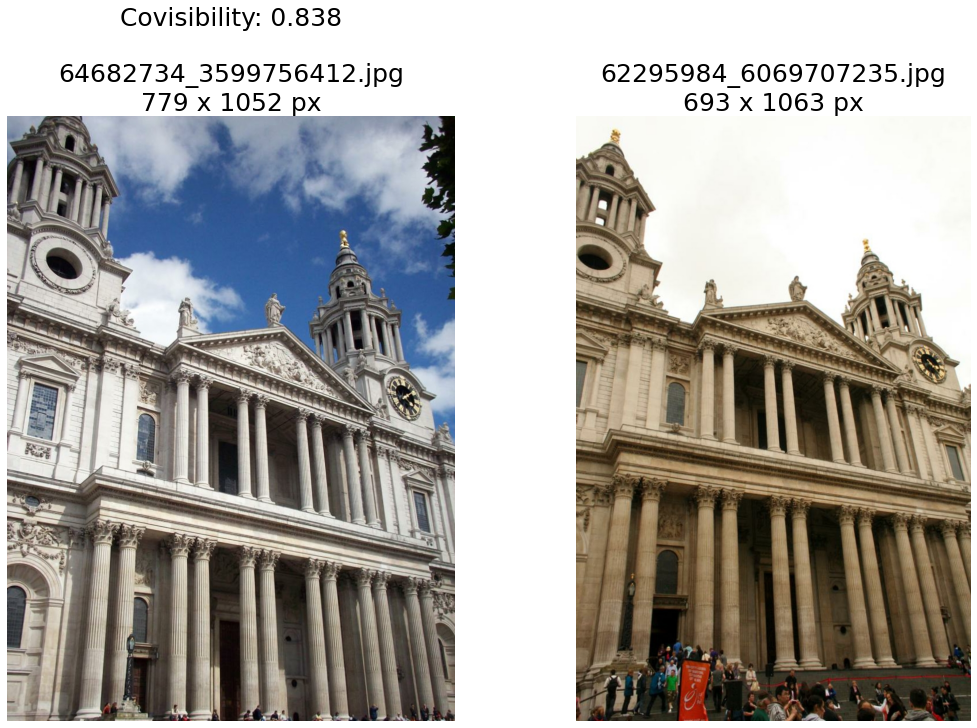

Pairs from a difficult subset


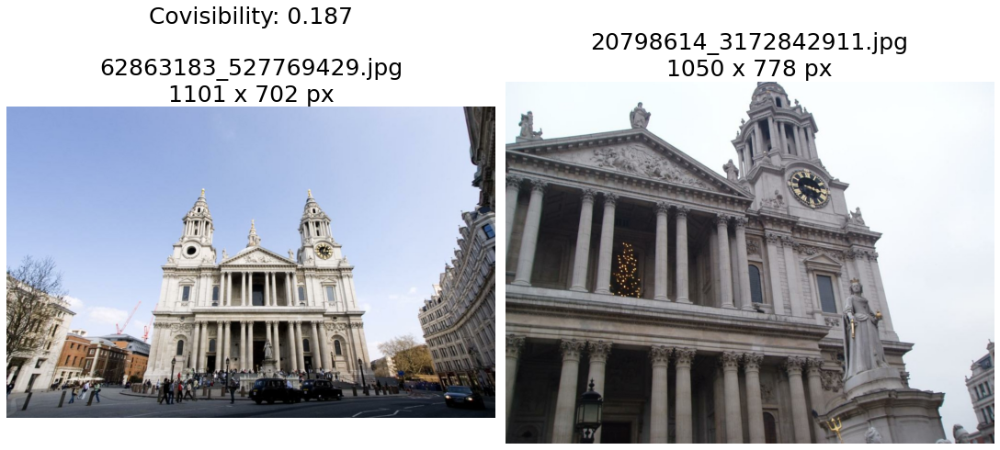

Pairs from a very difficult subset


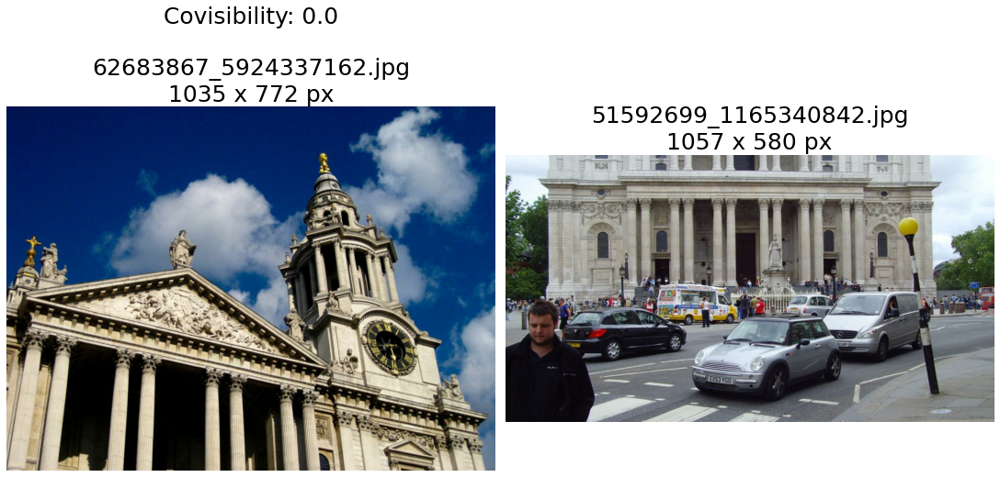

St Peters Square
Pairs from an easy subset


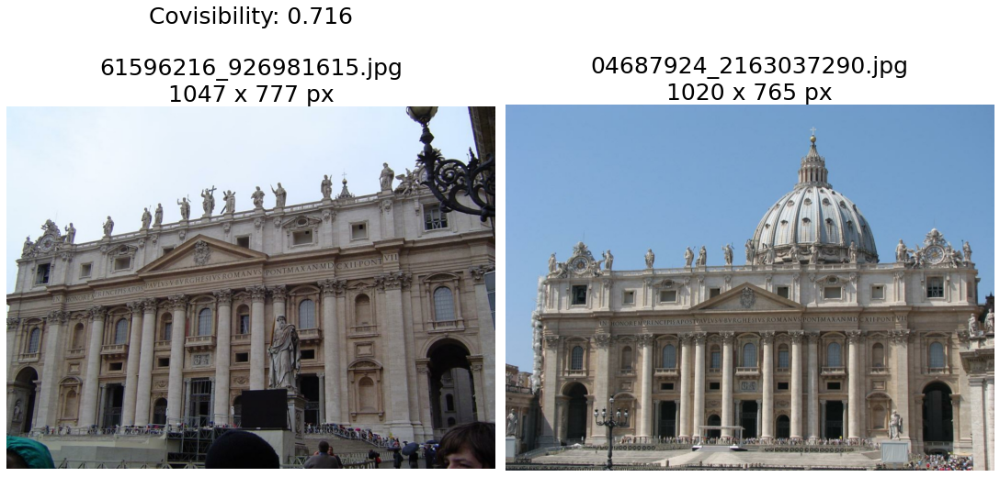

Pairs from a difficult subset


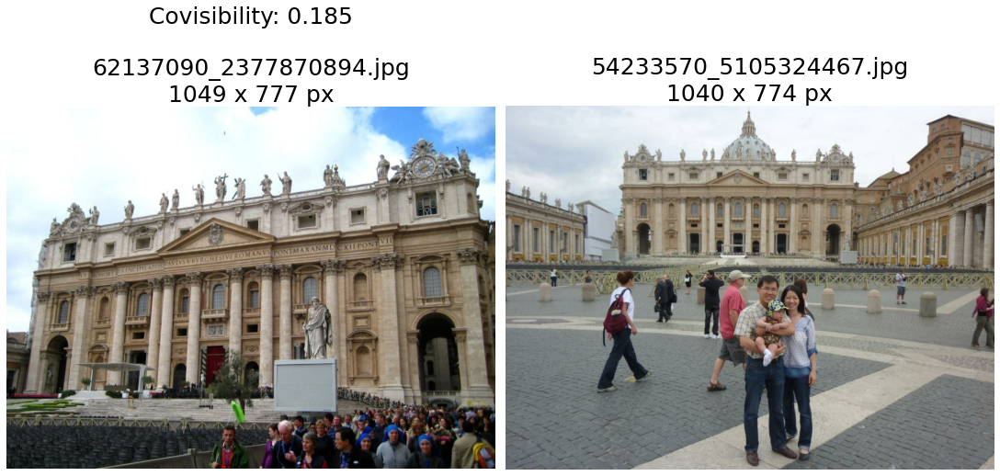

Pairs from a very difficult subset


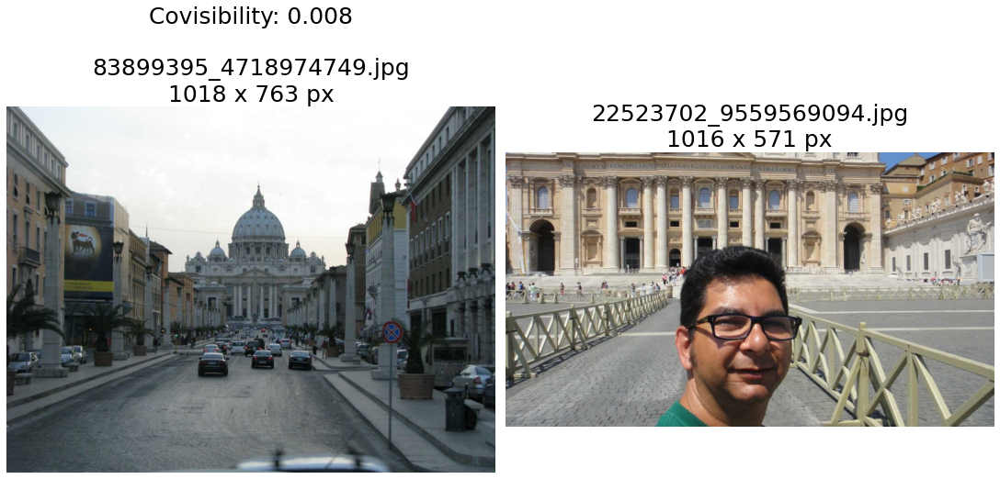

Taj Mahal
Pairs from an easy subset


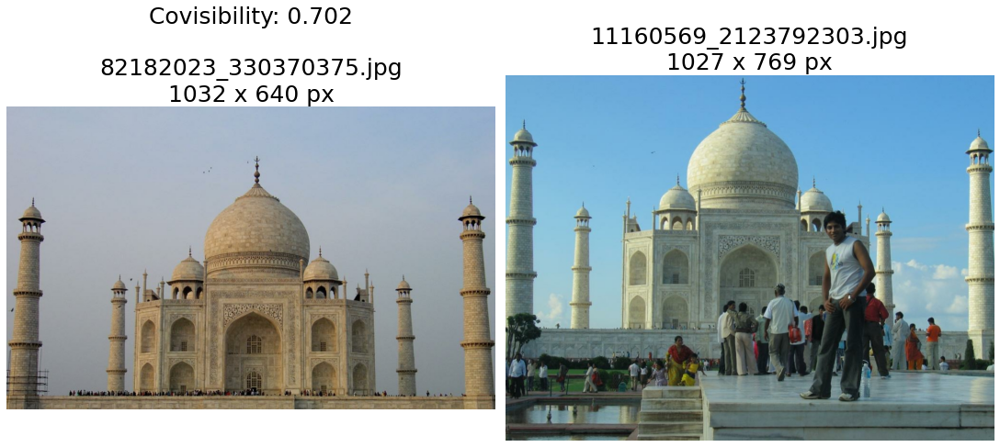

Pairs from a difficult subset


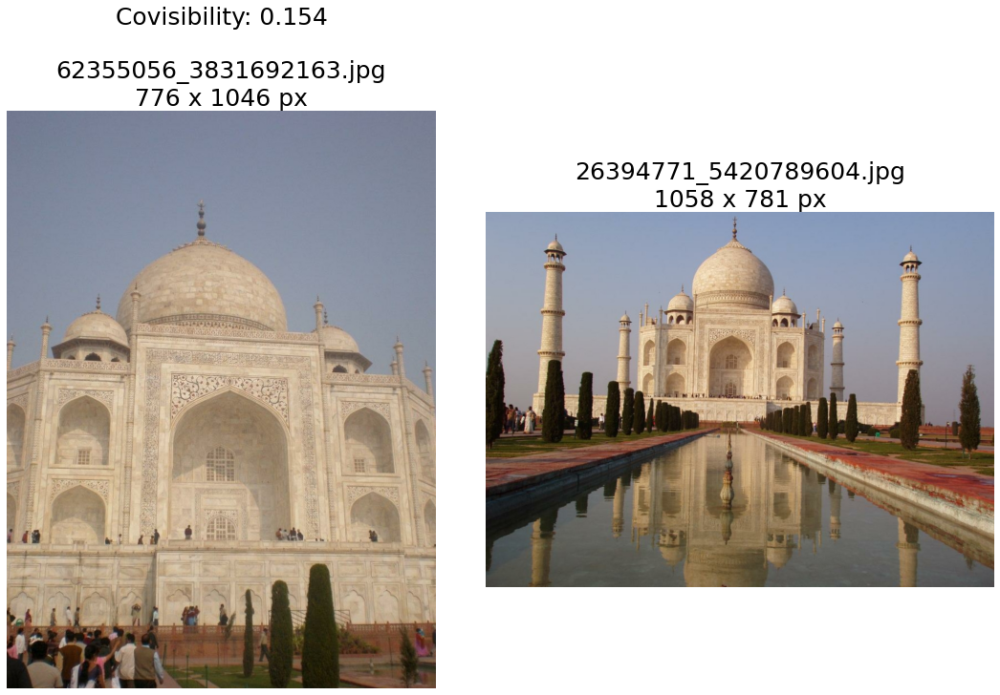

Pairs from a very difficult subset


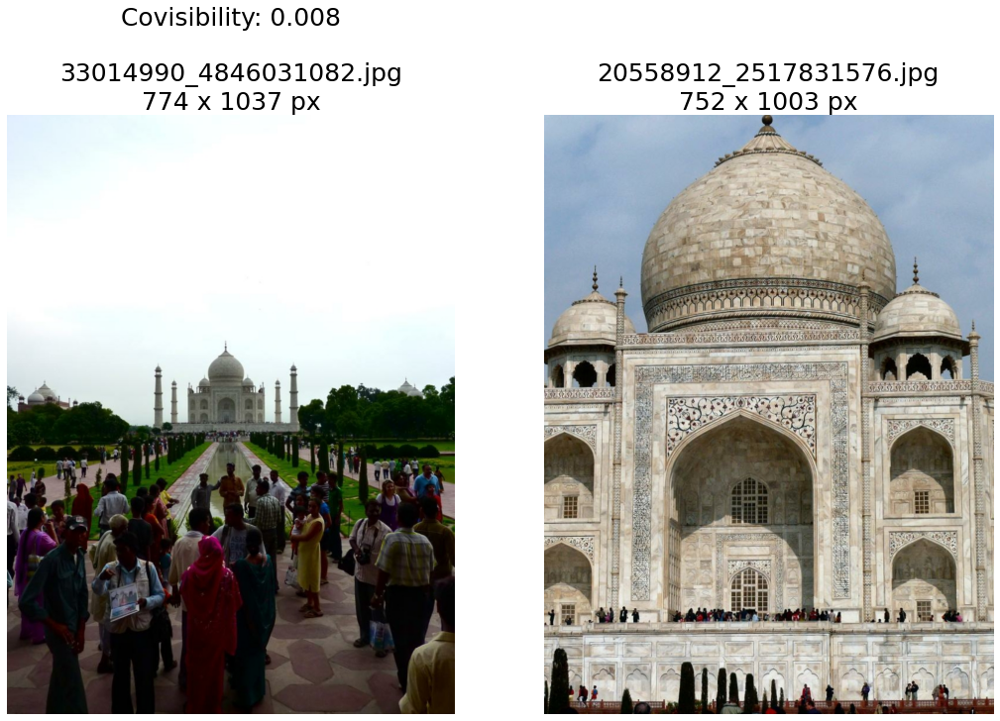

Temple Nara Japan
Pairs from an easy subset


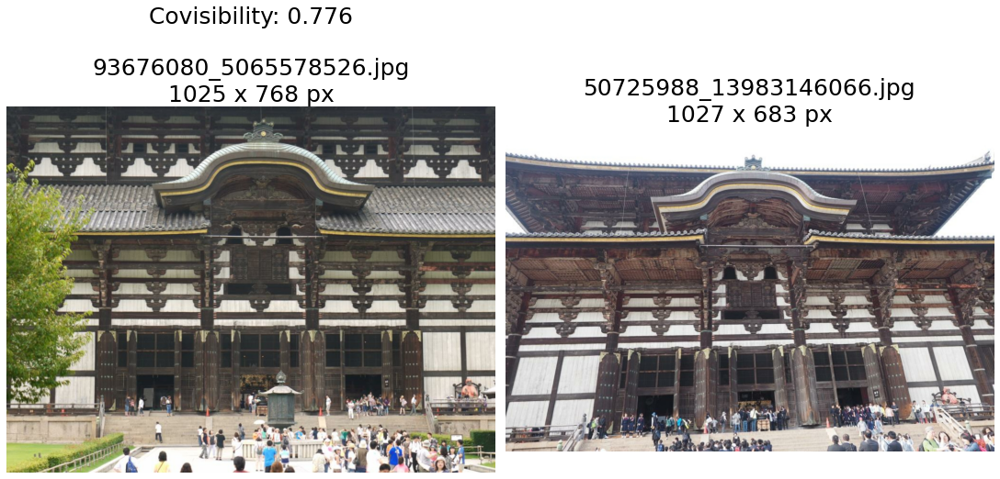

Pairs from a difficult subset


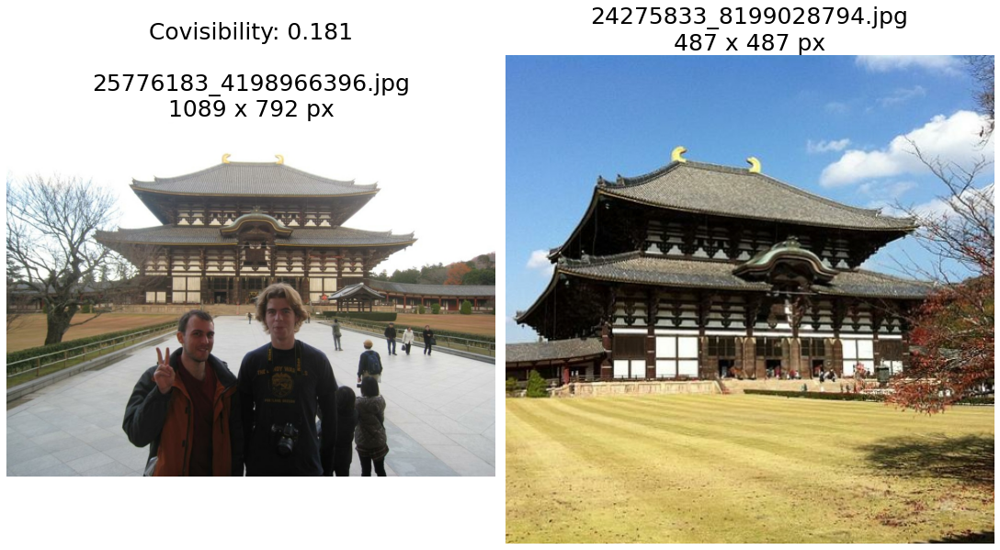

Trevi Fountain
Pairs from an easy subset


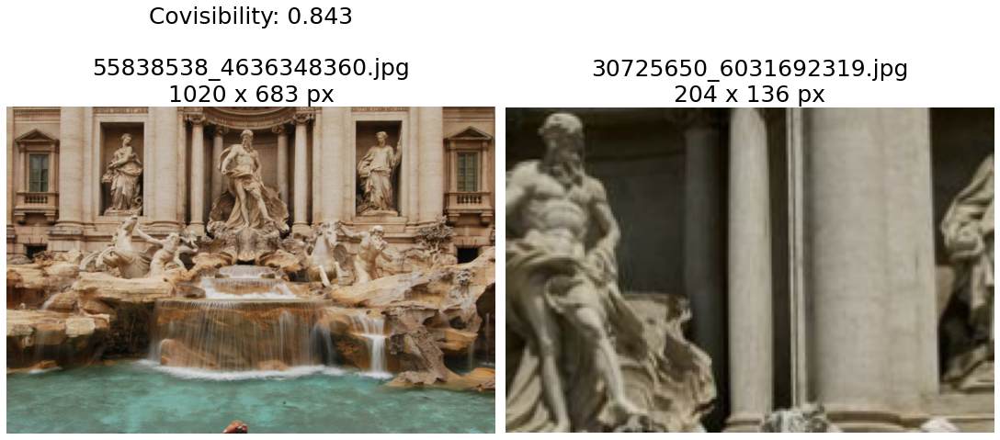

Pairs from a difficult subset


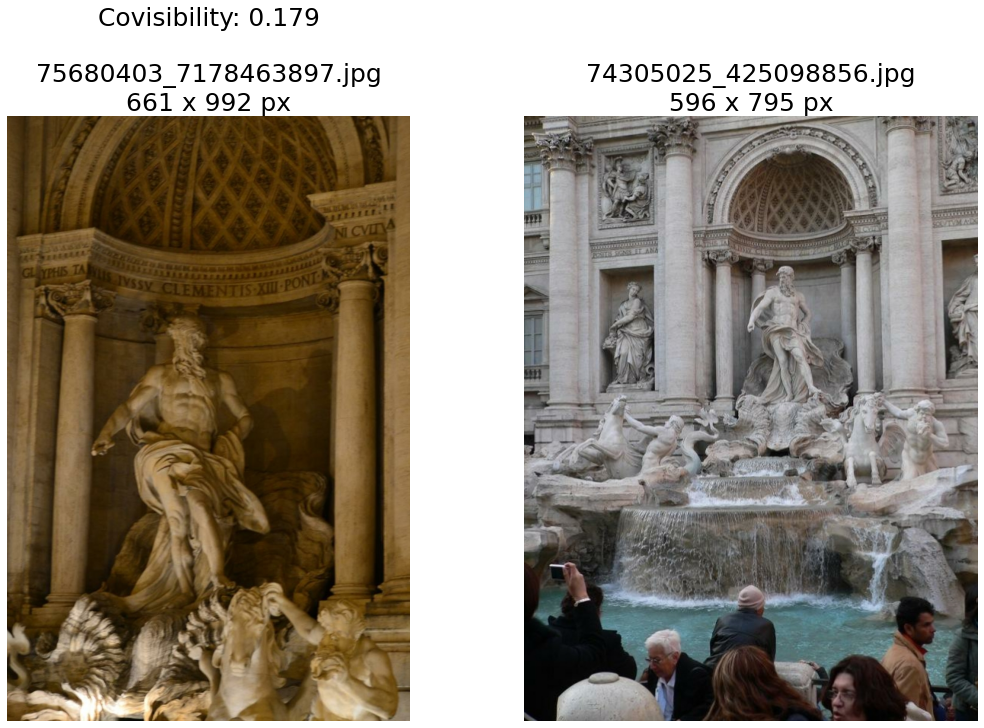

Pairs from a very difficult subset


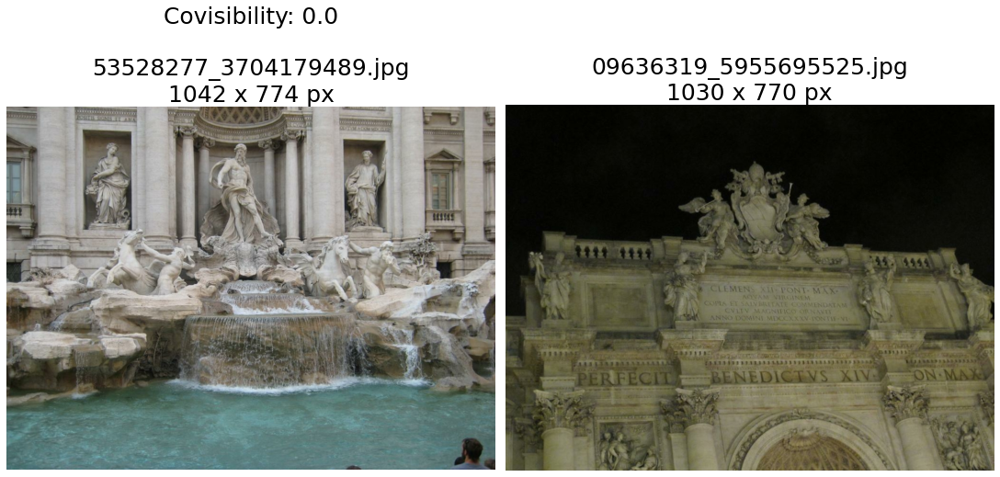

In [30]:
for dictionary, scene in zip(covisibility_list, scenes):

    easy_subset = [[k,v] for k, v in dictionary.items() if v >= 0.7]
    difficult_subset = [[k,v] for k, v in dictionary.items() if v >= 0.1 and v < 0.2]
    very_difficult_subset = [[k,v] for k, v in dictionary.items() if v < 0.01]
    
    print(scene.title().replace("_", " "))
    
    for i, subset in enumerate([easy_subset, difficult_subset, very_difficult_subset]):
        if len(subset) == 0:
            continue
        else:
            rand = random.randrange(1,len(subset))
            for pair in subset[rand:rand+1]: # change this to int if you don't want random/more pictures
                if i == 0:
                    print("Pairs from an easy subset")
                elif i == 1:
                    print("Pairs from a difficult subset")
                else:
                    print("Pairs from a very difficult subset")
                image_id_1, image_id_2 = pair[0].split('-')
                f, axes = plt.subplots(1, 2, figsize=(15, 10), constrained_layout=True)
                img1 = cv2.imread(f"{input_dir}/{scene}/images/{image_id_1}.jpg", cv2.IMREAD_UNCHANGED)
                img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)                
                axes[0].imshow(img1)
                axes[0].set_title(f"Covisibility: {pair[1]}\n\n" + image_id_1 + ".jpg\n" + str(img1.shape[1]) + ' x ' + str(img1.shape[0]) + ' px', fontsize = 25)
                img2 = cv2.imread(f"{input_dir}/{scene}/images/{image_id_2}.jpg", cv2.IMREAD_UNCHANGED)
                img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
                axes[1].imshow(img2)
                axes[1].set_title(image_id_2 + ".jpg\n" + str(img2.shape[1]) + ' x ' + str(img2.shape[0]) + ' px', fontsize = 25)
                for ax in axes:
                    ax.axis('off')
                plt.show()

In [31]:
def load_pairs_and_cal(scenes, input_dir):
    """
    load the image data from the correcsponding directory, together with the pairing metrics.
    Args:
        scenes:     List of scenes (folder names under /train)
        input_dir    String of the directory to source image data from

    Returns:
        pair: dataframe containing the image pairings
        calibration: dataframe contaaining the calibration data per image, including the corresponding scene
    """
    pair = pd.DataFrame()    
    calibration = pd.DataFrame()
    # path which contains all the categories of images
    j = 0
    for scene in scenes:
        print(f'loading category {j+1} of {len(scenes)}: {scene}')
        j += 1

        # read and concatenate pairing datasets. add the "scene" column.
        pairpath = os.path.join(input_dir,scene,"pair_covisibility.csv")
        if pair.empty:
            pair = pd.read_csv(pairpath)
            pair["scene"] = str(scene)
        else:
            pairappend = pd.read_csv(pairpath)
            pairappend["scene"] = str(scene)
            pair = pd.concat([pair,pairappend],axis=0)

        # read and concatenate calibration data, add the "scene" column.
        calibrationpath = os.path.join(input_dir,scene,"calibration.csv")
        if calibration.empty:
            calibration = pd.read_csv(calibrationpath)
            calibration["scene"] = str(scene)
        else:
            calibrationappend = pd.read_csv(calibrationpath)
            calibrationappend["scene"] = str(scene)
            calibration = pd.concat([calibration,calibrationappend],axis=0)

    return pair, calibration

In [32]:
pairings, calibration = load_pairs_and_cal(scenes,input_dir)
pairings.info()

loading category 1 of 16: brandenburg_gate
loading category 2 of 16: british_museum
loading category 3 of 16: buckingham_palace
loading category 4 of 16: colosseum_exterior
loading category 5 of 16: grand_place_brussels
loading category 6 of 16: lincoln_memorial_statue
loading category 7 of 16: notre_dame_front_facade
loading category 8 of 16: pantheon_exterior
loading category 9 of 16: piazza_san_marco
loading category 10 of 16: sacre_coeur
loading category 11 of 16: sagrada_familia
loading category 12 of 16: st_pauls_cathedral
loading category 13 of 16: st_peters_square
loading category 14 of 16: taj_mahal
loading category 15 of 16: temple_nara_japan
loading category 16 of 16: trevi_fountain
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1416814 entries, 0 to 248864
Data columns (total 4 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   pair                1416814 non-null  object 
 1   covisibility        1416814 

In [33]:
pairings.head(10)

,pair,covisibility,fundamental_matrix,scene
0,90920828_5082887495-20133057_3035445116,0.905,-9.27158516e-04 1.22034601e-01 -9.87725452e+01...,brandenburg_gate
1,90920828_5082887495-17262282_1141017004,0.936,1.68899800e-03 1.18269247e-01 -1.02939518e+02 ...,brandenburg_gate
2,20133057_3035445116-17262282_1141017004,0.908,-5.56308440e-04 1.74170978e-02 -2.49391042e+01...,brandenburg_gate
3,38600512_2168650655-17262282_1141017004,0.901,1.26837683e-02 -5.42924979e-01 4.29820975e+02 ...,brandenburg_gate
4,60770994_853214983-17262282_1141017004,0.912,-1.05214974e-02 -4.87393290e-01 3.90468870e+02...,brandenburg_gate
5,95850075_1570642878-82795354_2835662202,0.817,-9.16664807e-01 2.01662103e+01 -1.30803084e+04...,brandenburg_gate
6,95850075_1570642878-49325118_2768773629,0.869,-2.39227245e+00 1.42801978e+01 -7.09549102e+03...,brandenburg_gate
7,95850075_1570642878-53543924_286554986,0.858,1.35545675e+00 1.04485247e+01 -8.45644437e+03 ...,brandenburg_gate
8,95850075_1570642878-62661350_182339698,0.823,2.89741298e-01 1.51674274e+01 -1.03697071e+04 ...,brandenburg_gate
9,95733753_243743733-54233019_1901167706,0.810,5.88109584e-02 4.75825867e+00 -3.14986632e+03 ...,brandenburg_gate


/var/folders/y1/3f2y0dq512vb2w9b2q564p880000gn/T/ipykernel_13075/2627530391.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(scenes_formatted);


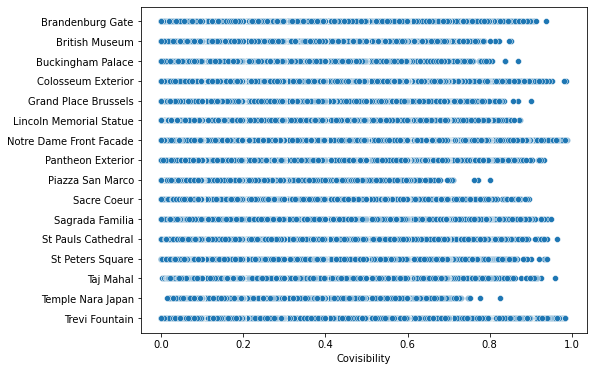

In [34]:
plt.figure(figsize=(8,6))
#plt.figure(dpi= 300) # use this for a high quality figure
ax = sns.scatterplot(data = pairings, x = 'covisibility', y = 'scene', legend=None, color='tab:blue')
ax.set_xlabel('Covisibility')
ax.set_ylabel('')
ax.set_yticklabels(scenes_formatted);